# Grupowanie k-średnich z wykorzystaniem t-SNE (zamienione na algorymt Birch)

## Wczytywanie danych w sparku

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!git clone https://github.com/PiotrMaciejKowalski/BigData2024Project.git
#%cd BigData2024Project
#!git checkout your-branch
#%cd ..

fatal: destination path 'BigData2024Project' already exists and is not an empty directory.


In [3]:
!chmod 755 /content/BigData2024Project/src/setup.sh
!/content/BigData2024Project/src/setup.sh

In [4]:
import sys
sys.path.append('/content/BigData2024Project/src')

In [5]:
from start_spark import initialize_spark
initialize_spark()

In [6]:
import pandas as pd
from pyspark.sql import SparkSession

from big_mess.loaders import default_loader, load_single_month, load_anotated, save_to_csv, preprocessed_loader

In [7]:
spark = SparkSession.builder\
        .master("local")\
        .appName("Colab")\
        .config('spark.ui.port', '4050')\
        .getOrCreate()

In [8]:
NASA_an = pd.read_csv('/content/drive/MyDrive/BigMess/NASA/NASA_an.csv',sep=';')
NASA_an["pustynia_i_step"] = NASA_an["pustynia"] + NASA_an["step"]

## Import bibliotek

In [9]:
!pip install datashader
!pip install holoviews hvplot colorcet
!pip install geoviews

In [10]:
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from collections.abc import Iterable
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go
from typing import List, Union
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score
import datashader as ds
import datashader.transfer_functions as tf
import colorcet as cc
import holoviews as hv
from holoviews.operation.datashader import datashade
import geoviews as gv
import geoviews.tile_sources as gts
from holoviews import opts
from IPython.display import IFrame
from IPython.core.display import display
from bokeh.plotting import show, output_notebook
from sklearn.cluster import Birch
import warnings
warnings.filterwarnings('ignore')

## Tworzenie funkcji

In [11]:
def StandardScaling(df: pd.DataFrame, attributes: list) -> pd.DataFrame:
  """
  Funkcja służąca do przeskalowania wybranych atrybutów za pomocą funkcji StandardScaler, a następnie stworzenia nowej ramki danych z tylko przeskalowanymi atrybutami.
  Parametry:
  - df (DataFrame): Pandas DataFrame zawierająca co najmniej atrybuty,
  - attributes (str): atrybuty, które będziemy skalować.
  """
  scaled_data = StandardScaler().fit_transform(df[attributes])
  scaled_df = pd.DataFrame(scaled_data, columns=attributes)
  return scaled_df

In [12]:
def MinMaxScaling(df: pd.DataFrame, attributes: list) -> pd.DataFrame:
  """
  Funkcja służąca do przeskalowania wybranych atrybutów za pomocą funkcji MinMaxScaler, a następnie stworzenia nowej ramki danych z tylko przeskalowanymi atrybutami.
  Parametry:
  - df (DataFrame): Pandas DataFrame zawierająca co najmniej atrybuty,
  - attributes (str): atrybuty, które będziemy skalować.
  """
  scaled_data = MinMaxScaler().fit_transform(df[attributes])
  scaled_df = pd.DataFrame(scaled_data, columns=attributes)
  return scaled_df

In [13]:
'''
Funkcja jako argumenty bierze listę wartości określających granice przedziałów liczbowych, które
będą określać jak dla rozważanego parametru mają zmieniać się kolory punktów, których lista stanowi
drugi argument funkcji.
'''
def get_colormap(values: list, colors_palette: list, name = 'custom'):
    values = np.sort(np.array(values))
    values = np.interp(values, (values.min(), values.max()), (0, 1))
    cmap = mpl.colors.LinearSegmentedColormap.from_list(name, list(zip(values, colors_palette)))
    return cmap

In [14]:
def plot_map(df: pd.DataFrame, parameter_name: str, colormap: mpl.colors.LinearSegmentedColormap, title: str,
             point_size: int = 8, width: int = 800, height: int = 500, alpha: float = 1,
             bgcolor: str = 'white', colorbar_verbose: bool = False):

    gdf = gv.Points(df, ['lon', 'lat'], [parameter_name]) # obiekt zawierający punkty
    tiles = gts.OSM # wybór mapy tła, w tym wypadku OpenStreetMap

    # łączenie mapy tła z punktami i ustawienie wybranych parametrów wizualizacji
    map_with_points = tiles * gdf.opts(
        title=title,
        color=parameter_name,
        cmap=colormap,
        size=point_size,
        width=width,
        height=height,
        colorbar=colorbar_verbose,
        toolbar='above',
        tools=['hover', 'wheel_zoom', 'reset'],
        alpha=alpha, # przezroczystość
        bgcolor=bgcolor
    )

    return hv.render(map_with_points)

## Przygotowanie danych

Ponieważ poprzednie analizy pokazały, że grupowanie na podstawie miesięcy zimowych nie przynosi pozytywnych rezultatów, ograniczymy się do analizy miesięcy wiosennych, letnich i jesiennych.

In [ ]:
nasa_202305 = load_single_month(spark, year=2023, month=5).toPandas()
nasa_202306 = load_single_month(spark, year=2023, month=6).toPandas()
nasa_202307 = load_single_month(spark, year=2023, month=7).toPandas()
nasa_202308 = load_single_month(spark, year=2023, month=8).toPandas()
nasa_202309 = load_single_month(spark, year=2023, month=9).toPandas()

In [ ]:
list_of_df = [nasa_202305, nasa_202306, nasa_202307, nasa_202308, nasa_202309]

In [ ]:
# Skalowanie danych
list_of_scaled_df = []
for dataframe in list_of_df:
  X = dataframe.loc[:,'Rainf':'SoilM_100_200cm']
  X_scaled = MinMaxScaling(StandardScaling(X, X.columns), X.columns)
  X_scaled = pd.concat([dataframe[["lon", "lat"]], X_scaled], axis=1)
  list_of_scaled_df.append(X_scaled)

# Grupowanie algorytmem Birch

**Birch** to oszczędzający pamięć algorytm do nauki online, stanowiący alternatywę dla MiniBatchKMeans. Konstruuje drzewiastą strukturę danych, w której centroidy klastrów są odczytywane z liścia.

In [ ]:
# Grupowanie i dodanie kolumny "Cluster" do DataFramów
for scaled_df in list_of_scaled_df:
  birch_model = Birch(threshold=0.06, n_clusters=2)
  birch_model.fit(scaled_df.loc[:,'Rainf':'SoilM_100_200cm'])
  birch_results = birch_model.predict(scaled_df.loc[:,'Rainf':'SoilM_100_200cm'])
  scaled_df['Cluster'] = birch_results

In [ ]:
for df, col_name in zip(list_of_scaled_df, list_of_df):
  colormap_cluster = get_colormap([0, max(df["Cluster"].values)], ['darkgreen', 'orange'])
  output_notebook()
  show(plot_map(df=df, parameter_name='Cluster', colormap=colormap_cluster, title=f"Dane z {col_name.loc[0,'Month']}.{col_name.loc[0,'Year']}", alpha=0.5))

In [ ]:
listed_of_merged_df = []
for df in list_of_scaled_df:
  merged_df = df[['lon', 'lat', 'Cluster']].merge(NASA_an[['lon', 'lat', 'pustynia', 'pustynia_i_step']], left_on=['lon','lat'], right_on = ['lon','lat'], how='inner')
  listed_of_merged_df.append(merged_df)

In [ ]:
predykcje_df = pd.DataFrame({"Predykcje 10.2022": listed_of_merged_df[0]['Cluster'],
                       "Predykcje 04.2023": listed_of_merged_df[1]['Cluster'],
                       "Predykcje 05.2023": listed_of_merged_df[2]['Cluster'],
                       "Predykcje 06.2023": listed_of_merged_df[3]['Cluster'],
                       "Predykcje 07.2023": listed_of_merged_df[4]['Cluster'],
                       "Predykcje 08.2023": listed_of_merged_df[5]['Cluster'],
                       "Predykcje 09.2023": listed_of_merged_df[6]['Cluster']})

In [ ]:
wyniki = pd.DataFrame({"Name": ["Predykcje 10.2022","Predykcje 04.2023","Predykcje 05.2023","Predykcje 06.2023","Predykcje 07.2023","Predykcje 08.2023","Predykcje 09.2023"]})
wyniki["Accuracy [%]"] = wyniki["Name"].apply(lambda name: round(accuracy_score(listed_of_merged_df[0]["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["Precision [%]"] = wyniki["Name"].apply(lambda name: round(precision_score(listed_of_merged_df[0]["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["Recall [%]"] = wyniki["Name"].apply(lambda name: round(recall_score(listed_of_merged_df[0]["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["F1-Score [%]"] = wyniki["Name"].apply(lambda name: round(f1_score(listed_of_merged_df[0]["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki.sort_values(by=['Accuracy [%]'], ascending=False)

,Name,Accuracy [%],Precision [%],Recall [%],F1-Score [%]
3,Predykcje 06.2023,84.42,89.06,50.89,64.77
4,Predykcje 07.2023,84.25,71.51,73.21,72.35
5,Predykcje 08.2023,82.50,63.71,87.80,73.84
6,Predykcje 09.2023,79.15,57.95,94.35,71.80
2,Predykcje 05.2023,75.04,53.21,93.75,67.89
1,Predykcje 04.2023,50.08,13.89,14.88,14.37
0,Predykcje 10.2022,34.92,5.27,7.74,6.27


# Tunning hiperparametrów modelu trenowanego na danych z lipca 2023

In [19]:
X = nasa_202307.loc[:,'Rainf':'SoilM_100_200cm']
X_scaled = MinMaxScaling(StandardScaling(X, X.columns), X.columns)
X_scaled = pd.concat([nasa_202307[["lon", "lat"]], X_scaled], axis=1)
merged_df = X_scaled.merge(NASA_an[['lon', 'lat', 'pustynia', 'pustynia_i_step']], left_on=['lon','lat'], right_on = ['lon','lat'], how='inner')

In [20]:
for threshold in (0.03, 0.04):
  for branching_factor in (50,55,60):
    birch_model = Birch(n_clusters=2, threshold=threshold, branching_factor=branching_factor)
    birch_model.fit(X_scaled.loc[:,'Rainf':'SoilM_100_200cm'])
    birch_results = birch_model.predict(merged_df.loc[:,'Rainf':'SoilM_100_200cm'])
    print("Threshold: ", threshold, "Branching factor: ", branching_factor)
    print(np.unique(birch_results, return_counts=True))
    print("Accuracy: ", round(accuracy_score(merged_df["pustynia_i_step"], birch_results)*100, 2))
    print("Precision: ", round(precision_score(merged_df["pustynia_i_step"], birch_results)*100, 2))
    print("Recall: ", round(recall_score(merged_df["pustynia_i_step"], birch_results)*100, 2))
    print("F1-score: ", round(f1_score(merged_df["pustynia_i_step"], birch_results)*100, 2))
    print("- - - - - - - - - - - - - -")

Threshold:  0.03 Branching factor:  50
(array([0, 1]), array([664, 530]))
Accuracy:  81.24
Precision:  60.57
Recall:  95.54
F1-score:  74.13
- - - - - - - - - - - - - -
Threshold:  0.03 Branching factor:  55
(array([0, 1]), array([709, 485]))
Accuracy:  84.0
Precision:  64.95
Recall:  93.75
F1-score:  76.74
- - - - - - - - - - - - - -
Threshold:  0.03 Branching factor:  60
(array([0, 1]), array([686, 508]))
Accuracy:  83.42
Precision:  63.58
Recall:  96.13
F1-score:  76.54
- - - - - - - - - - - - - -
Threshold:  0.04 Branching factor:  50
(array([0, 1]), array([695, 499]))
Accuracy:  83.17
Precision:  63.53
Recall:  94.35
F1-score:  75.93
- - - - - - - - - - - - - -
Threshold:  0.04 Branching factor:  55
(array([0, 1]), array([742, 452]))
Accuracy:  84.09
Precision:  66.15
Recall:  88.99
F1-score:  75.89
- - - - - - - - - - - - - -
Threshold:  0.04 Branching factor:  60
(array([0, 1]), array([719, 475]))
Accuracy:  83.67
Precision:  64.84
Recall:  91.67
F1-score:  75.96
- - - - - - - -

In [21]:
birch_model = Birch(n_clusters=2, threshold=0.04, branching_factor=55)
birch_model.fit(X_scaled.loc[:,'Rainf':'SoilM_100_200cm'])
birch_results = birch_model.predict(merged_df.loc[:,'Rainf':'SoilM_100_200cm'])

In [22]:
merged_df["Cluster"] = birch_results

In [24]:
colormap_cluster = get_colormap([0, max(birch_results)], ['darkgreen', "orange"])
output_notebook()
show(plot_map(df=merged_df, parameter_name='Cluster', colormap=colormap_cluster, title="Wyniki na zbiorze anotowanym", alpha=0.5))

# Wnioski

* Grupowanie k-średnich z wykorzystaniem t-SNE nie powiodło się sukcesem ze
względu na duży zbiór danych. Po zastosowaniu algorytmu dla różnych wartości preplexity oraz learning_rate algorytm nie rozdzielił danych, co uniemożliwiło grupowanie.
* Grupowanie hierarchiczne dla parametrów linkage: "ward", "average", "complete" nie powiodło się ponieważ na Colabie jest zbyt mała pamięć RAM i za każdym razem usuwało sesję. Grupowanie to zadziałało tylko dla linkage = "single" jednak wyniki na zbiorze anotowanym były gorsze od tych powyżej.
* Grupowanie algorytmem Birch nie zrobiło szału. Wyniki podobne lub trochę gorsze od zwykłego algorytmu k-średnich.

# Pomysły, które nie zakończyły się sukcesem

In [ ]:
def do_kmeans_and_return_df_with_cluster_column(df: pd.DataFrame, scaled_df: pd.DataFrame, n_clusters: int, init: str, random_state: int) -> pd.DataFrame:
  """
  Funkcja wykonuje grupowanie k-średnich dla n_clusters klastrów oraz tworzy nową kolumnę z predykcjami algorytmu k-średnich w ramce danych df.
  Parametry:
  - df (DataFrame): Pandas DataFrame zawierająca co najmniej te same kolumny co scaled_df,
  - scaled_df (DataFrame): Pandas DataFrame zawierająca przeskalowane kolumny, na podstawie których dokonywane jest grupowanie,
  - n_clusters (int): maksymalna liczba klastrów,
  - random_state (int): ziarno losowości.
  """
  kmeans = KMeans(n_clusters = n_clusters, init = init, random_state = random_state)
  kmeans.fit(scaled_df)
  pred = kmeans.predict(scaled_df)
  df['cluster'] = pred
  return df

In [ ]:
def plot_2d_tsne_for_three_different_perplexities(list_of_perplexities: Iterable[int], scaled_df: pd.DataFrame, czy_step_to_pustynia: bool=False) -> None:
  """
  Funkcja tworzy trzy wykresy dla różnych wartości perplexity.
  Parametry:
  - list_of_perplexities - lista wartości perplexity dla których chcemy stworzyć wykresy,
  - scaled_df - ramka danych z już przeskalowanymi wartościami na podstawie której wykonujemy algorytm t-SNE,
  - df_with_target - ramka danych w której znajdują się kolumny "pustynia" i "step",
  - czy_step_to_pustynia - wartość logiczna, gdy TRUE to traktujemy step jako pustynię.
  """
  fig, axes = plt.subplots(ncols=3, figsize=(18, 6))

  scaled_df_train = scaled_df.loc[:,'Rainf':'SoilM_100_200cm']

  for perplexity, ax in zip(list_of_perplexities, axes.flat):
    tsne = TSNE(n_components = 2, perplexity = perplexity, n_jobs=-1, random_state=2024)
    tsne_results = tsne.fit_transform(scaled_df_train)

    df = pd.DataFrame()
    df['dim 1'] = tsne_results[:,0]
    df['dim 2'] = tsne_results[:,1]
    if czy_step_to_pustynia:
      df['Cluster'] = scaled_df["pustynia_i_step"]
    else:
      df['Cluster'] = scaled_df["pustynia"]
    sns.scatterplot(x="dim 1", y="dim 2", hue="Cluster", palette = ["darkgreen", "orange", "blue"], data=df, legend="full", ax=ax).set(title=f'Perplexity: {perplexity}, Divergence: {round(tsne.kl_divergence_,3)}')


In [ ]:
def plot_3d_tsne(perplexity: float, scaled_df: pd.DataFrame, original_df: pd.DataFrame, anotated_df: pd.DataFrame, czy_step_to_pustynia: bool=False) -> None:
  """
  Funkcja tworzy wykres 3d dla wybranej wartości perplexity.
  Parametry:
  - list_of_perplexities - lista wartości perplexity dla których chcemy stworzyć wykresy,
  - scaled_df - ramka danych z już przeskalowanymi wartościami na podstawie której wykonujemy algorytm t-SNE,
  - df_with_target - ramka danych w której znajdują się kolumny "pustynia", "step", "lon" i "lat",
  - czy_step_to_pustynia - wartość logiczna, gdy TRUE to traktujemy step jako pustynię.
  """
  tsne = TSNE(n_components = 3, perplexity = perplexity)
  tsne_results = tsne.fit_transform(scaled_df)

  df_merged_with_anotated = original_df.merge(anotated_df[['lon', 'lat', 'pustynia', 'step', 'pustynia_i_step']], left_on=['lon','lat'], right_on = ['lon','lat'], how='left')
  df_merged_with_anotated.fillna(2, inplace=True)

  df = pd.DataFrame()
  df['dim 1'] = tsne_results[:,0]
  df['dim 2'] = tsne_results[:,1]
  df['dim 3'] = tsne_results[:,2]
  if czy_step_to_pustynia:
    df['Cluster'] = df_merged_with_anotated["pustynia_i_step"]
  else:
    df['Cluster'] = df_merged_with_anotated["pustynia"]

  fig = go.Figure(data=[go.Scatter3d(
    x=df['dim 1'],
    y=df['dim 2'],
    z=df['dim 3'],
    mode="markers",
    marker=dict(color=df['Cluster'], colorscale=["darkgreen", "orange"]),
    text = [f"Współrzędne: ({lat}, {lon})" for lat, lon in df_merged_with_anotated[["lat", "lon"]].values],
    hoverinfo='text'
  )])
  fig.update_layout(scene = dict(
                    xaxis_title='dim 1',
                    yaxis_title='dim 2',
                    zaxis_title='dim 3'))
  fig.update_layout(scene=dict(xaxis_showspikes=False,
                             yaxis_showspikes=False))
  fig.show()

In [ ]:
def do_kmeans_with_tsne_return_preds(list_of_scaled_df: List, n_components: int=2, perplexity:float=30, learning_rate: Union[float, str]="auto", n_clusters: int=2, random_state: int=123) -> List:
  warnings.filterwarnings('ignore')
  list_of_preds = []
  for scaled_df in list_of_scaled_df:
    tsne = TSNE(n_components = n_components, perplexity = perplexity, learning_rate=learning_rate)
    tsne_results = tsne.fit_transform(scaled_df)

    kmeans = KMeans(n_clusters = n_clusters, init = "k-means++", random_state = random_state)
    kmeans.fit(tsne_results)
    pred = kmeans.predict(tsne_results)
    list_of_preds.append(pred)
  return list_of_preds

In [ ]:
hierarchical_cluster_ward = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
labels_ward = hierarchical_cluster_ward.fit_predict(X_scaled.loc[:,'Rainf':'SoilM_100_200cm'])

In [ ]:
nasa_202307['Cluster'] = birch_result

In [ ]:
np.unique(labels_ward, return_counts=True)

(array([0, 1]), array([76062,     1]))

In [ ]:
colormap_cluster = get_colormap([0, max(nasa_202307['Cluster'].values)], ['darkgreen', "orange"])
output_notebook()
show(plot_map(df=nasa_202307, parameter_name='Cluster', colormap=colormap_cluster, title="Predykce", alpha=0.5))

In [ ]:
nasa_anotated_500_202307 = nasa_202307.merge(NASA_sample_an, left_on=['lon','lat'], right_on = ['lon','lat'], how='inner')
nasa_anotated_500_202307.head()

,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_40_100cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm,Year,Month,pustynia,step,pustynia_i_step
0,-112.0625,25.4375,0.964800,1.883201,298.404785,39.520161,294.855408,0.000000,303.411804,377.701813,199.971893,2023,7,1,0,1
1,-109.0625,25.6875,58.044201,45.939529,306.114685,31.357531,302.805786,0.400330,281.986389,70.506737,197.149902,2023,7,1,0,1
2,-102.1875,26.3125,4.008599,10.441710,298.365692,39.573929,296.397186,0.127404,361.098297,166.357193,171.955704,2023,7,1,0,1
3,-98.6875,26.4375,4.989500,30.466089,306.606903,30.727150,303.506989,0.289631,399.443512,97.866257,177.298294,2023,7,1,0,1
4,-102.9375,26.5625,16.882700,23.478500,298.631195,39.532261,296.726105,0.099987,366.214508,303.836700,142.494202,2023,7,0,1,1


In [ ]:
list_of_df = [nasa_202210, nasa_202304, nasa_202305, nasa_202306, nasa_202307, nasa_202308, nasa_202309]

In [ ]:
X = nasa_202307.loc[:,'Rainf':'SoilM_100_200cm']
X_scaled = MinMaxScaling(StandardScaling(X, X.columns), X.columns)
X_scaled = pd.concat([nasa_202307[["lon", "lat"]], X_scaled], axis=1)
X_scaled.head()

,lon,lat,Rainf,Evap,AvgSurfT,Albedo,SoilT_40_100cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm
0,-112.0625,25.0625,0.001285,0.011415,0.532846,0.979786,0.666908,0.002622,0.304209,0.431945,0.375136
1,-111.9375,25.0625,0.001180,0.007988,0.581390,0.981668,0.713301,0.002622,0.460418,0.404459,0.342842
2,-111.8125,25.0625,0.001075,0.005224,0.665632,0.981631,0.777007,0.000000,0.363647,0.178220,0.406147
3,-111.6875,25.0625,0.000982,0.004776,0.692042,0.981668,0.801342,0.000000,0.391130,0.174821,0.404227
4,-111.5625,25.0625,0.001149,0.005017,0.676920,0.981857,0.795265,0.000000,0.573843,0.231868,0.440048


In [ ]:
X = nasa_anotated_500_202307.loc[:,'Rainf':'SoilM_100_200cm']
X_scaled = MinMaxScaling(StandardScaling(X, X.columns), X.columns)
X_scaled = pd.concat([nasa_anotated_500_202307[["lon", "lat", "pustynia", "step", "pustynia_i_step"]], X_scaled], axis=1)
X_scaled.head()

,lon,lat,pustynia,step,pustynia_i_step,Rainf,Evap,AvgSurfT,Albedo,SoilT_40_100cm,GVEG,PotEvap,RootMoist,SoilM_100_200cm
0,-112.0625,25.4375,1,0,1,0.003045,0.009385,0.581366,0.997349,0.707876,0.000000,0.319422,0.495384,0.434186
1,-109.0625,25.6875,1,0,1,0.183176,0.285289,0.865243,0.594844,0.976324,0.404376,0.272296,0.085418,0.427363
2,-102.1875,26.3125,1,0,1,0.012650,0.062983,0.579926,1.000000,0.759935,0.128692,0.446305,0.213335,0.366451
3,-98.6875,26.4375,1,0,1,0.015746,0.188386,0.883366,0.563759,1.000000,0.292558,0.530647,0.121930,0.379368
4,-102.9375,26.5625,0,1,1,0.053279,0.144626,0.589702,0.997945,0.771041,0.100997,0.457559,0.396807,0.295221


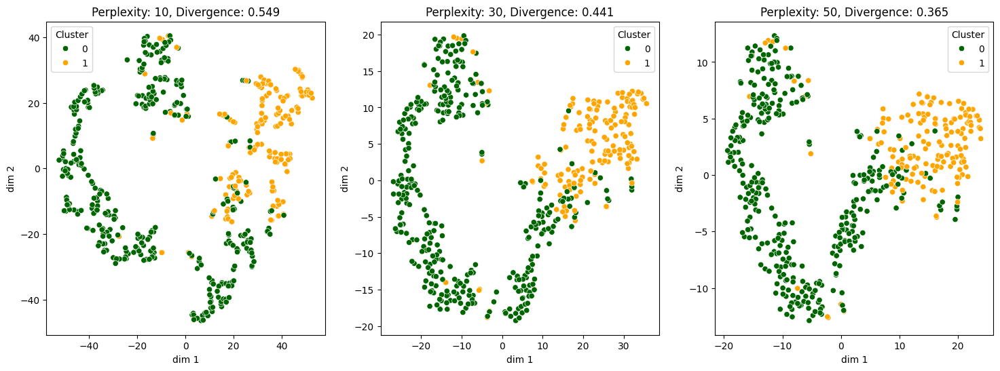

In [ ]:
plot_2d_tsne_for_three_different_perplexities([10,30,50], X_scaled, czy_step_to_pustynia=True)

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
tsne = TSNE(n_components = 2, perplexity = 50, learning_rate=10000, random_state=2024, n_jobs=-1)
tsne_results = tsne.fit_transform(X_scaled.loc[:,'Rainf':'SoilM_100_200cm'])

<Axes: xlabel='dim 1', ylabel='dim 2'>

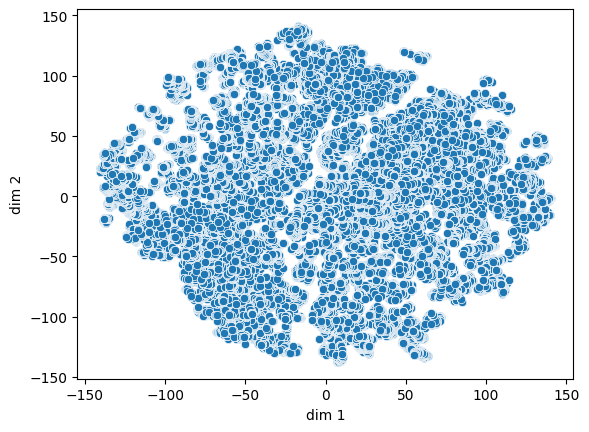

In [ ]:
df = pd.DataFrame()
df['dim 1'] = tsne_results[:,0]
df['dim 2'] = tsne_results[:,1]
sns.scatterplot(x="dim 1", y="dim 2", palette = ["darkgreen", "orange", "blue"], data=df, legend="full")

In [ ]:
df = pd.DataFrame()
df['dim 1'] = tsne_results[:,0]
df['dim 2'] = tsne_results[:,1]
df['Cluster'] = X_scaled["pustynia_i_step"]

In [ ]:
clf = LogisticRegression(random_state=0).fit(df[["dim 1", "dim 2"]], nasa_anotated_500_202307['pustynia_i_step'])

In [ ]:
df['Cluster pred'] = clf.predict(df[["dim 1", "dim 2"]])

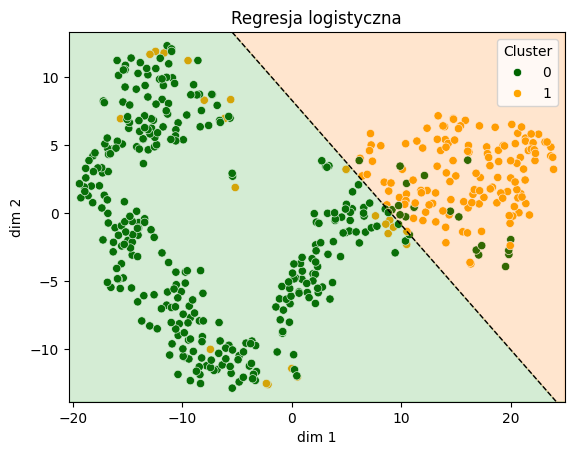

In [ ]:
sns.scatterplot(x="dim 1", y="dim 2", hue="Cluster", palette = ["darkgreen", "orange", "blue"], data=df, legend="full").set(ylim=(min(df['dim 2']-1), max(df['dim 2']+1)), xlim=(min(df['dim 1']-1), max(df['dim 1']+1)), title="Regresja logistyczna")
b = clf.intercept_[0]
w1, w2 = clf.coef_.T

c = -b/w2
m = -w1/w2

xmin, xmax = min(df['dim 1']-1), max(df['dim 1']+1)
ymin, ymax = min(df['dim 2']-1), max(df['dim 2']+1)
xd = np.array([xmin, xmax])
yd = m*xd + c
plt.plot(xd, yd, 'k', lw=1, ls='--')
plt.fill_between(xd, yd, ymin, color='tab:green', alpha=0.2)
plt.fill_between(xd, yd, ymax, color='tab:orange', alpha=0.2)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(clf.predict(df), nasa_anotated_500_202307['pustynia_i_step']))

              precision    recall  f1-score   support

           0       0.90      0.88      0.89       350
           1       0.74      0.77      0.75       150

    accuracy                           0.85       500
   macro avg       0.82      0.82      0.82       500
weighted avg       0.85      0.85      0.85       500



Do grupowania będziemy używać następujących wskaźników:

*   **Rainf** - wskaźnik opadów deszczu,
*   **Evap** - wskaźnik całkowitej ewapotranspiracji,
*   **AvgSurfT** - wskaźnik średniej temperatury powierzchni ziemi,
*   **Albedo** - wskaźnik albedo,
*   **SoilT_40_100cm** - wskaźnik temperatury gleby w warstwie o głębokości od 40 do 100 cm,
*   **GVEG** - wskaźnik roślinności,
*   **PotEvap** - wskaźnik potencjalnej ewapotranspiracji,
*   **RootMoist** - wilgotność gleby w strefie korzeniowej (parowanie, które miałoby miejsce, gdyby dostępne było wystarczające źródło wody),
*   **SoilM_100_200cm** - wilgotność gleby w warstwie o głębokości od 100 do 200 cm.

In [ ]:
# Elementy list_of_scaled_df są w kolejności chronologicznej tzn. list_of_scaled_df[0] to dane z 10.2022, a list_of_scaled_df[11] to dane z 09.2023.
list_of_scaled_df = []
for dataframe in list_of_df:
  X = dataframe.loc[:,'Rainf':'SoilM_100_200cm']
  X_scaled = MinMaxScaling(StandardScaling(X, X.columns), X.columns)
  X_scaled = pd.concat([dataframe[["lon", "lat"]], X_scaled], axis=1)
  list_of_scaled_df.append(X_scaled)

## Implementacja algorytmu k-średnich z wykorzystaniem t-SNE dla danych zanotowanych

Na początku spróbujmy dobrać optymalny hiperparametr *perplexity*. W tym celu przedstawmy na kilku wykresach wyniki algorytmu t-SNE dla różnych wartości perplexity.

**Przypadek 1.** step nie jest pustynią.

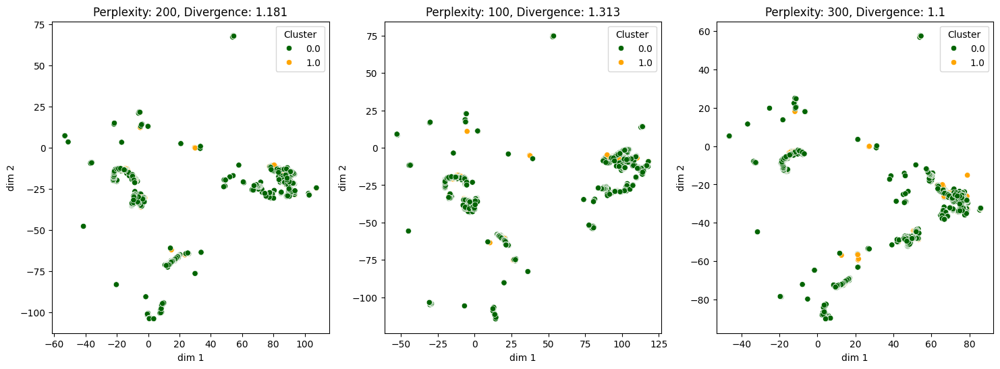

In [ ]:
plot_2d_tsne_for_three_different_perplexities([200,100,300], list_of_scaled_df[6], nasa_anotated)

In [ ]:
plot_3d_tsne(30, list_of_scaled_df[11], df_202309, False)

**Przypadek 2.** step jest pustynią.

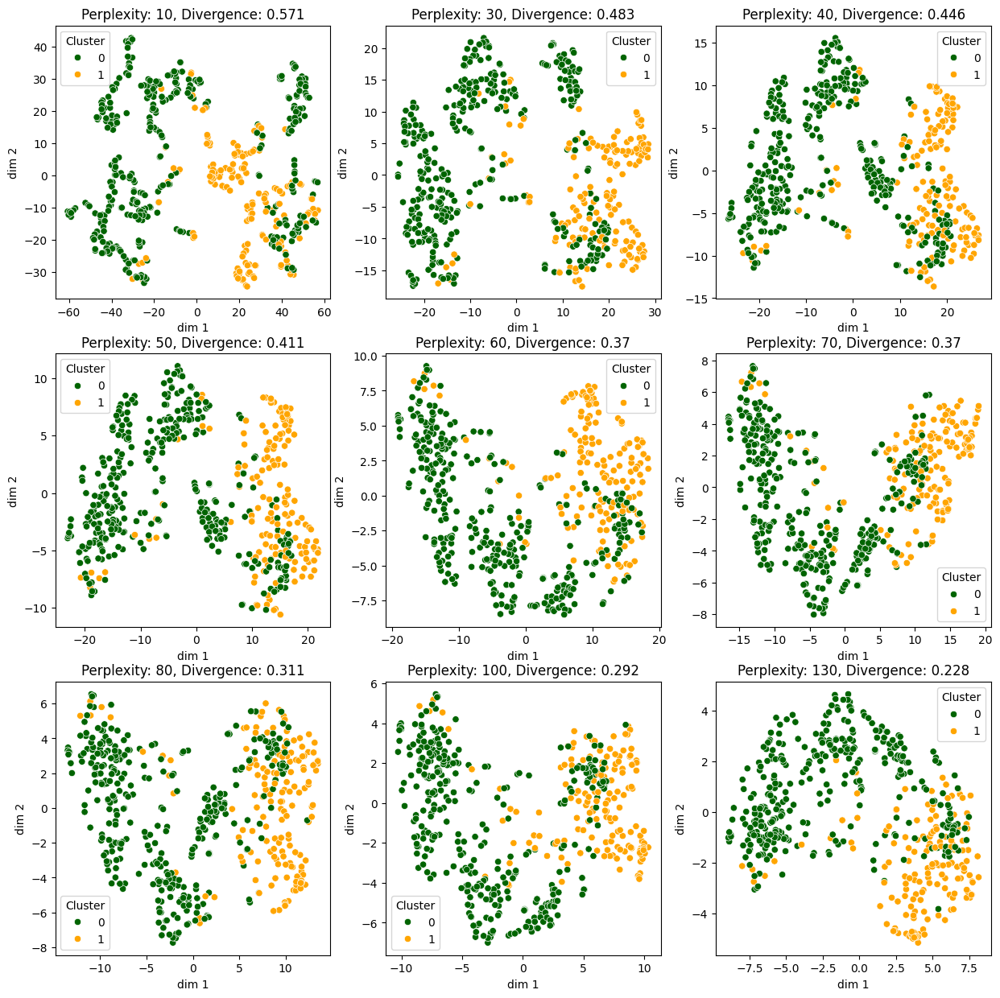

In [ ]:
plot_2d_tsne_for_nine_different_perplexities([10,30,40,50,60,70,80,100,130], list_of_scaled_df[11], df_202309, True)

In [ ]:
plot_3d_tsne(30, list_of_scaled_df[11], df_202309, True)

Spróbujmy użyć wartość perplexity = 50.

In [ ]:
predykcje = do_kmeans_with_tsne_return_preds(list_of_scaled_df, perplexity=50, n_components=3)

In [ ]:
predykcje_df = pd.DataFrame({"Predykcje 10.2022": predykcje[0],
                       "Predykcje 04.2023": predykcje[6],
                       "Predykcje 05.2023": predykcje[7],
                       "Predykcje 06.2023": predykcje[8],
                       "Predykcje 07.2023": predykcje[9],
                       "Predykcje 08.2023": predykcje[10],
                       "Predykcje 09.2023": predykcje[11]})

In [ ]:
predykcje_df.head(7)

,Predykcje 10.2022,Predykcje 11.2022,Predykcje 12.2022,Predykcje 01.2023,Predykcje 02.2023,Predykcje 03.2023,Predykcje 04.2023,Predykcje 05.2023,Predykcje 06.2023,Predykcje 07.2023,Predykcje 08.2023,Predykcje 09.2023
0,0,0,1,0,1,1,1,0,0,1,0,1
1,0,0,1,0,1,1,1,0,0,1,0,1
2,0,0,1,0,1,1,1,0,0,1,0,1
3,0,0,1,0,1,1,1,0,0,1,0,1
4,0,0,1,0,1,1,1,0,0,1,0,1
5,0,0,1,0,1,1,1,0,0,1,0,1
6,1,0,1,0,1,1,1,0,0,0,1,0


In [ ]:
#predykcje_df["Predykcje 08.2023"] = predykcje_df["Predykcje 08.2023"].apply(lambda x: 1 if x==0 else 1)
#predykcje_df["Predykcje 09.2023"] = predykcje_df["Predykcje 09.2023"].apply(lambda x: 1 if x==0 else 1)

#predykcje_df["Predykcje 10.2022"] = predykcje_df["Predykcje 10.2022"].apply(lambda x: 1 if x==0 else 1)
#predykcje_df["Predykcje 05.2023"] = predykcje_df["Predykcje 05.2023"].apply(lambda x: 1 if x==0 else 1)
#predykcje_df["Predykcje 02.2023"] = predykcje_df["Predykcje 02.2023"].apply(lambda x: 1 if x==0 else 1)

## Wyniki

Tak wyglądają Stany Zjednoczone.

In [ ]:
display(IFrame("https://www.google.com/maps/embed?pb=!1m14!1m12!1m3!1d13982681.959428234!2d-98.66341902257437!3d38.39997874427714!2m3!1f0!2f0!3f0!3m2!1i1024!2i768!4f13.1!5e1!3m2!1spl!2spl!4v1703000232420!5m2!1spl!2spl", '800px', '500px'))

**Przypadek 1.** step nie jest pustynią

In [ ]:
colormap_cluster = get_colormap([0, max(df_202309['pustynia'].values)], ['darkgreen', "orange"])
output_notebook()
show(plot_map(df=df_202309, parameter_name='pustynia', colormap=colormap_cluster, title="Dane zanotowane, step nie jest pustynią", alpha=0.5))

In [ ]:
wyniki = pd.DataFrame({"Name": ["Predykcje 10.2022","Predykcje 04.2023","Predykcje 05.2023","Predykcje 06.2023","Predykcje 07.2023","Predykcje 08.2023","Predykcje 09.2023"]})
wyniki["Accuracy [%]"] = wyniki["Name"].apply(lambda name: round(accuracy_score(df_202309["pustynia"], predykcje_df[name])*100, 2))
wyniki["Precision [%]"] = wyniki["Name"].apply(lambda name: round(precision_score(df_202309["pustynia"], predykcje_df[name])*100, 2))
wyniki["Recall [%]"] = wyniki["Name"].apply(lambda name: round(recall_score(df_202309["pustynia"], predykcje_df[name])*100, 2))
wyniki["F1-Score [%]"] = wyniki["Name"].apply(lambda name: round(f1_score(df_202309["pustynia"], predykcje_df[name])*100, 2))
wyniki.sort_values(by=['Accuracy [%]'], ascending=False)

,Name,Accuracy [%],Precision [%],Recall [%],F1-Score [%]
9,Predykcje 07.2023,72.8,33.66,100.00,50.36
6,Predykcje 04.2023,63.6,27.13,97.10,42.41
11,Predykcje 09.2023,62.8,27.06,100.00,42.59
1,Predykcje 11.2022,51.2,13.99,49.28,21.79
2,Predykcje 12.2022,50.2,17.86,72.46,28.65
3,Predykcje 01.2023,48.2,7.96,26.09,12.20
4,Predykcje 02.2023,47.8,20.19,94.20,33.25
5,Predykcje 03.2023,45.4,18.32,85.51,30.18
7,Predykcje 05.2023,44.2,0.93,2.90,1.41
8,Predykcje 06.2023,43.6,0.47,1.45,0.70


**Przypadek 2.** step jest pustynią

In [ ]:
colormap_cluster = get_colormap([0, max(df_202309['pustynia_i_step'].values)], ['darkgreen', "orange"])
output_notebook()
show(plot_map(df=df_202309, parameter_name='pustynia_i_step', colormap=colormap_cluster, title="Dane zanotowane, step jest pustynią", alpha=0.5))

In [ ]:
wyniki = pd.DataFrame({"Name": ["Predykcje 10.2022","Predykcje 04.2023","Predykcje 05.2023","Predykcje 06.2023","Predykcje 07.2023","Predykcje 08.2023","Predykcje 09.2023"]})
wyniki["Accuracy [%]"] = wyniki["Name"].apply(lambda name: round(accuracy_score(df_202309["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["Precision [%]"] = wyniki["Name"].apply(lambda name: round(precision_score(df_202309["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["Recall [%]"] = wyniki["Name"].apply(lambda name: round(recall_score(df_202309["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki["F1-Score [%]"] = wyniki["Name"].apply(lambda name: round(f1_score(df_202309["pustynia_i_step"], predykcje_df[name])*100, 2))
wyniki.sort_values(by=['Accuracy [%]'], ascending=False)

,Name,Accuracy [%],Precision [%],Recall [%],F1-Score [%]
10,Predykcje 08.2023,83.0,66.99,89.74,76.71
11,Predykcje 09.2023,76.2,57.43,91.67,70.62
9,Predykcje 07.2023,76.0,57.20,91.67,70.44
8,Predykcje 06.2023,75.4,57.02,85.90,68.54
2,Predykcje 12.2022,54.2,35.80,58.97,44.55
6,Predykcje 04.2023,53.6,35.04,57.05,43.41
3,Predykcje 01.2023,53.4,34.54,55.13,42.47
5,Predykcje 03.2023,52.6,35.16,61.54,44.76
1,Predykcje 11.2022,48.6,30.35,50.00,37.77
0,Predykcje 10.2022,31.2,31.20,100.00,47.56


In [ ]:
for dataframe, col_name in zip(list_of_df, predykcje_df.columns):
  dataframe["Cluster"] = predykcje_df[col_name]
  colormap_cluster = get_colormap([0, max(dataframe["Cluster"].values)], ['darkgreen', 'orange'])
  output_notebook()
  show(plot_map(df=dataframe, parameter_name='Cluster', colormap=colormap_cluster, title=f"{col_name}, k-średnich z t-SNE", alpha=0.5))